<a href="https://colab.research.google.com/github/L191138/Artigo-Mestrado/blob/main/Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# How to Train Detectron2 on Custom Objects

This tutorial implements the new [Detectron2 Library](https://ai.facebook.com/blog/-detectron2-a-pytorch-based-modular-object-detection-library-/) by facebook. This notebook shows training on **your own custom objects** for object detection.

It is worth noting that the Detectron2 library goes far beyond object detection, supporting semantic segmentation, keypoint detection, mask, and densepose.


### Accompanying Blog Post

We recommend that you follow along in this notebook while reading the blog post on [how to train Detectron2](https://blog.roboflow.ai/how-to-train-detectron2/), concurrently.

### Steps Covered in this Tutorial

In this tutorial, we will walk through the steps required to train Detectron2 on your custom objects. We use a [public blood cell detection dataset](https://public.roboflow.ai/object-detection/bccd), which is open source and free to use. You can also use this notebook on your own data.

To train our detector we take the following steps:

* Install Detectron2 dependencies
* Download custom Detectron2 object detection data
* Visualize Detectron2 training data
* Write our Detectron2 Training configuration
* Run Detectron2 training
* Evaluate Detectron2 performance
* Run Detectron2 inference on test images



### **About**

[Roboflow](https://roboflow.ai) enables teams to deploy custom computer vision models quickly and accurately. Convert data from to annotation format, assess dataset health, preprocess, augment, and more. It's free for your first 1000 source images.

#### ![Roboflow Workmark](https://i.imgur.com/WHFqYSJ.png)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Install Detectron2 Dependencies

In [ ]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
ERROR: Could not find a version that satisfies the requirement torch==1.5 (from versions: 1.11.0, 1.12.0, 1.12.1, 1.13.0, 1.13.1, 2.0.0, 2.0.1)
ERROR: No matching distribution found for torch==1.5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 5.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44091 sha256=3b659cd200144a5011106e79051a2485619203fdc1c8612561c8638e0afa59f4
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0.1
    Uninstalling PyYAML-6.0.1:
      Successfully uninstalled PyYAML-6.0.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependen

In [ ]:
# install detectron2:
!pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-1fv8mtfp
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-1fv8mtfp
  Resolved https://github.com/facebookresearch/detectron2.git to commit 57bdb21249d5418c130d54e2ebdc94dda7a4c01a
  Preparing metadata (setup.py) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 1.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 11.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 16.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  

In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [ ]:
 !curl -L "https://app.roboflow.com/ds/86SweRnidX?key=GDbx6YDeBV" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

#!unzip "/content/drive/MyDrive/Mestrado_PCB/banco de dados/dataset.coco.zip"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   892  100   892    0     0   2071      0 --:--:-- --:--:-- --:--:--  2074
100  181M  100  181M    0     0  89.9M      0  0:00:02  0:00:02 --:--:--  164M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/Boa-48-_png.rf.bdd4f9b5a218fa3240fe2825d3efd96e.jpg  
 extracting: test/Ruim-74-_png.rf.122c726237fd720f23e96ee10936150c.jpg  
 extracting: test/Ruim-85-_png.rf.5e1e21abbefa756b4d5fff07eb086aac.jpg  
 extracting: test/_annotations.coco.json  
   creating: train/
 extracting: train/Boa-1-_png.rf.432ce8469291df2edc581d156523d1b9.jpg  
 extracting: train/Boa-10-_png.rf.349c05bfebe71685ab9d6ee322d9d7a8.jpg  
 extracting: train/Boa-11-_png.rf.8fd55fdcd5337551b72067ad5eda2c39.jpg  
 extracting: train/Boa-12-_png.rf.669dc81e5743fe366479a661de86fdfc.

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [07/27 13:13:04 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[07/27 13:13:04 d2.data.datasets.coco]: Loaded 169 images in COCO format from /content/train/_annotations.coco.json


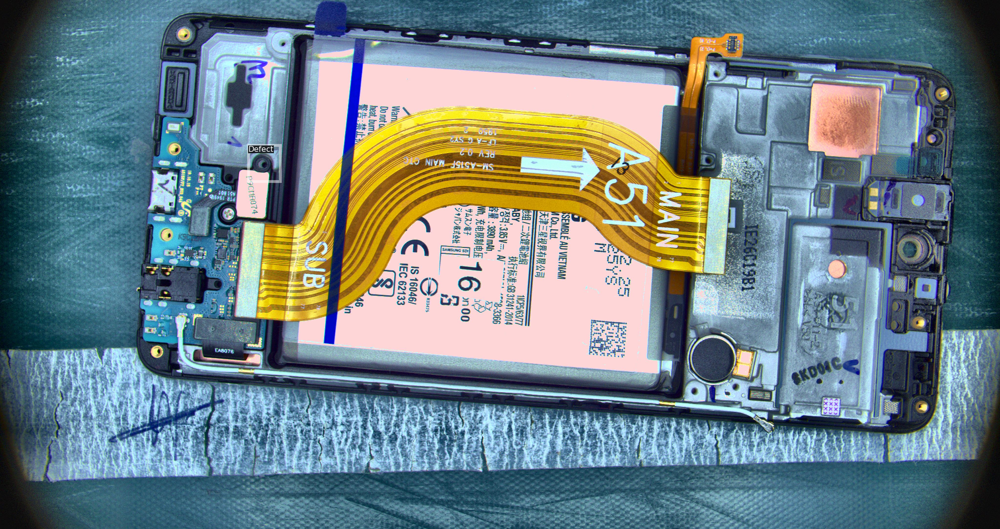

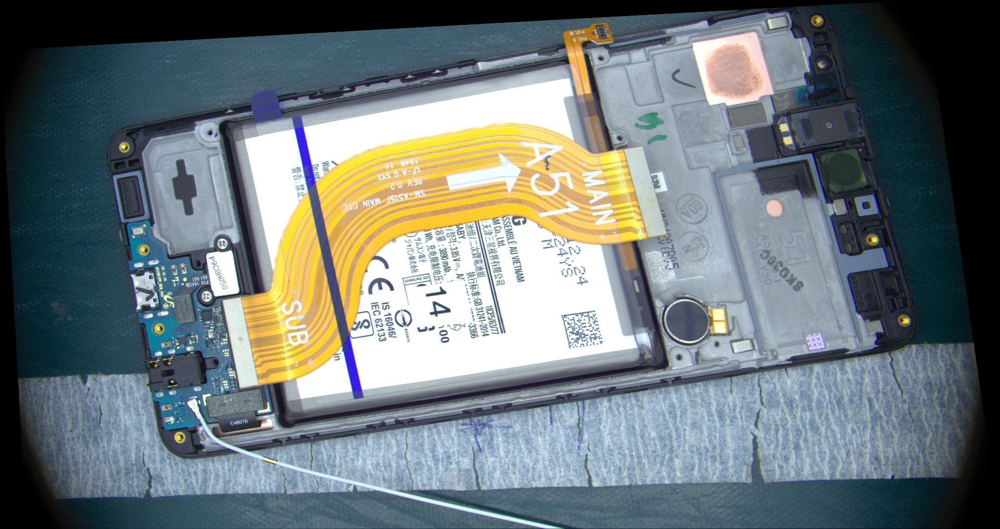

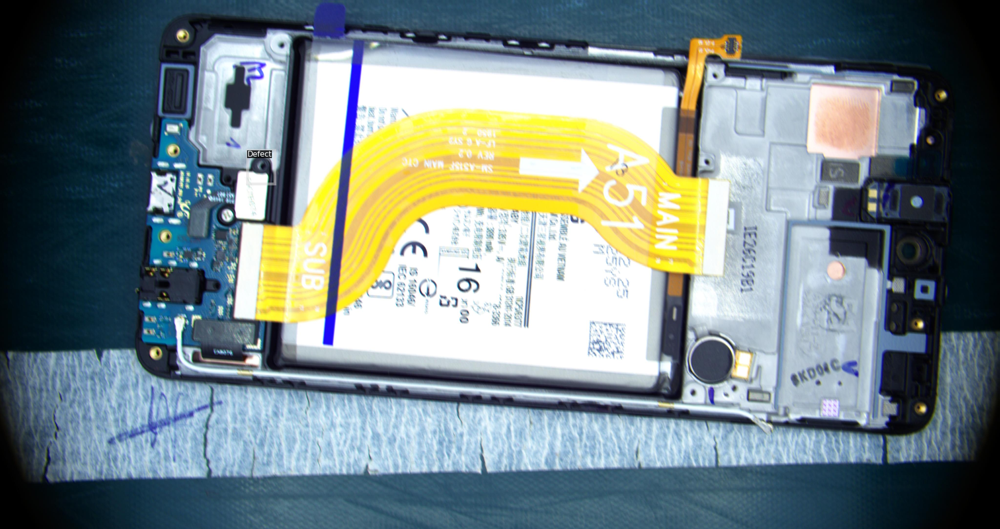

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [ ]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
#rom .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
 #select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1490)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 8
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[07/27 13:42:03 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
model_final_68b088.pkl: 421MB [00:01, 279MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[07/27 13:42:05 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[07/27 13:42:54 d2.utils.events]:  eta: 0:46:06  iter: 19  total_loss: 1.365  loss_cls: 1.101  loss_box_reg: 0.01244  loss_rpn_cls: 0.2004  loss_rpn_loc: 0.01316    time: 1.8692  last_time: 1.9452  data_time: 0.0878  last_data_time: 0.0255   lr: 1.931e-07  max_mem: 5501M
[07/27 13:43:39 d2.utils.events]:  eta: 0:46:28  iter: 39  total_loss: 1.368  loss_cls: 1.086  loss_box_reg: 0.01078  loss_rpn_cls: 0.1579  loss_rpn_loc: 0.009468    time: 1.9756  last_time: 2.0650  data_time: 0.0133  last_data_time: 0.0146   lr: 2.911e-07  max_mem: 5501M
[07/27 13:44:20 d2.utils.events]:  eta: 0:46:40  iter: 59  total_loss: 1.359  loss_cls: 1.066  loss_box_reg: 0.008698  loss_rpn_cls: 0.2244  loss_rpn_loc: 0.0111    time: 1.9933  last_time: 1.7635  data_time: 0.0136  last_data_time: 0.0073   lr: 3.891e-07  max_mem: 5502M
[07/27 13:44:59 d2.utils.events]:  eta: 0:46:30  iter: 79  total_loss: 1.332  loss_cls: 1.084  loss_box_reg: 0.008214  loss_rpn_cls: 0.1448  loss_rpn_loc: 0.009751    time: 1.9879  la

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[07/27 13:59:09 d2.evaluation.evaluator]: Inference done 11/40. Dataloading: 0.0067 s/iter. Inference: 0.2954 s/iter. Eval: 0.0005 s/iter. Total: 0.3027 s/iter. ETA=0:00:08
[07/27 13:59:14 d2.evaluation.evaluator]: Inference done 27/40. Dataloading: 0.0275 s/iter. Inference: 0.3043 s/iter. Eval: 0.0028 s/iter. Total: 0.3356 s/iter. ETA=0:00:04
[07/27 13:59:20 d2.evaluation.evaluator]: Inference done 39/40. Dataloading: 0.0610 s/iter. Inference: 0.3054 s/iter. Eval: 0.0024 s/iter. Total: 0.3697 s/iter. ETA=0:00:00
[07/27 13:59:20 d2.evaluation.evaluator]: Total inference time: 0:00:12.979073 (0.370831 s / iter per device, on 1 devices)
[07/27 13:59:20 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:10 (0.304569 s / iter per device, on 1 devices)
[07/27 13:59:20 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[07/27 13:59:20 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[07/27 13:59:20 d2.evaluation.coco_ev

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[07/27 14:16:15 d2.evaluation.evaluator]: Inference done 11/40. Dataloading: 0.0151 s/iter. Inference: 0.2958 s/iter. Eval: 0.0008 s/iter. Total: 0.3118 s/iter. ETA=0:00:09
[07/27 14:16:20 d2.evaluation.evaluator]: Inference done 27/40. Dataloading: 0.0196 s/iter. Inference: 0.2962 s/iter. Eval: 0.0015 s/iter. Total: 0.3176 s/iter. ETA=0:00:04
[07/27 14:16:25 d2.evaluation.evaluator]: Inference done 39/40. Dataloading: 0.0505 s/iter. Inference: 0.2997 s/iter. Eval: 0.0021 s/iter. Total: 0.3529 s/iter. ETA=0:00:00
[07/27 14:16:25 d2.evaluation.evaluator]: Total inference time: 0:00:12.478659 (0.356533 s / iter per device, on 1 devices)
[07/27 14:16:25 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:10 (0.299156 s / iter per device, on 1 devices)
[07/27 14:16:25 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[07/27 14:16:25 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[07/27 14:16:25 d2.evaluation.coco_ev

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[07/27 14:33:26 d2.evaluation.evaluator]: Inference done 11/40. Dataloading: 0.1238 s/iter. Inference: 0.3316 s/iter. Eval: 0.0062 s/iter. Total: 0.4616 s/iter. ETA=0:00:13
[07/27 14:33:31 d2.evaluation.evaluator]: Inference done 25/40. Dataloading: 0.0920 s/iter. Inference: 0.3072 s/iter. Eval: 0.0026 s/iter. Total: 0.4023 s/iter. ETA=0:00:06
[07/27 14:33:36 d2.evaluation.evaluator]: Inference done 39/40. Dataloading: 0.0835 s/iter. Inference: 0.2994 s/iter. Eval: 0.0017 s/iter. Total: 0.3855 s/iter. ETA=0:00:00
[07/27 14:33:37 d2.evaluation.evaluator]: Total inference time: 0:00:13.531560 (0.386616 s / iter per device, on 1 devices)
[07/27 14:33:37 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:10 (0.299260 s / iter per device, on 1 devices)
[07/27 14:33:37 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[07/27 14:33:37 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[07/27 14:33:37 d2.evaluation.coco_ev

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="/content/output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[07/27 14:33:45 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [07/27 14:33:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [07/27 14:33:46 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[07/27 14:33:46 d2.data.datasets.coco]: Loaded 3 images in COCO format from /content/test/_annotations.coco.json
[07/27 14:33:46 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
| Parafusos  | 0            |   Defect   | 2            |
|            |              |            |              |
|   total    | 2            |            |              |
[07/27 14:33:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[07/27 14:33:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.428054 (0.428054 s / iter per device, on 1 devices)
[07/27 14:33:48 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.278803 s / iter per device, on 1 devices)
[07/27 14:33:48 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[07/27 14:33:48 d2.evaluation.coco_evaluation]: Saving results to /content/output/coco_instances_results.json
[07/27 14:33:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[07/27 14:33:48 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[07/27 14:33:48 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.00 seconds.
[07/27 14:33:48 d2.evaluation.fast_eval_api]: Accumulating evaluation results...
[07/27 14:33:48 d2.evaluation.fast_eval_api]: COCOeval_opt.accumulate() finished in 0.01 seconds.
 Average Precisio

OrderedDict([('bbox',
              {'AP': 11.950495049504953,
               'AP50': 50.495049504950494,
               'AP75': 0.0,
               'APs': nan,
               'APm': nan,
               'APl': 13.381188118811881,
               'AP-Parafusos': nan,
               'AP-Defect': 11.950495049504953})])

# Inference with Detectron2 Saved Weights



In [ ]:
%ls /content/output

NotImplementedError: ignored

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[07/27 14:43:29 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


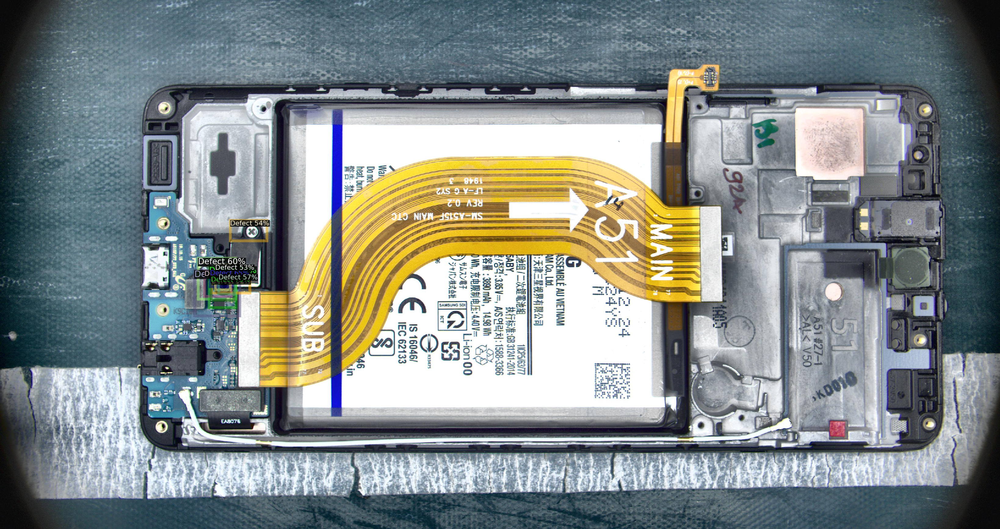

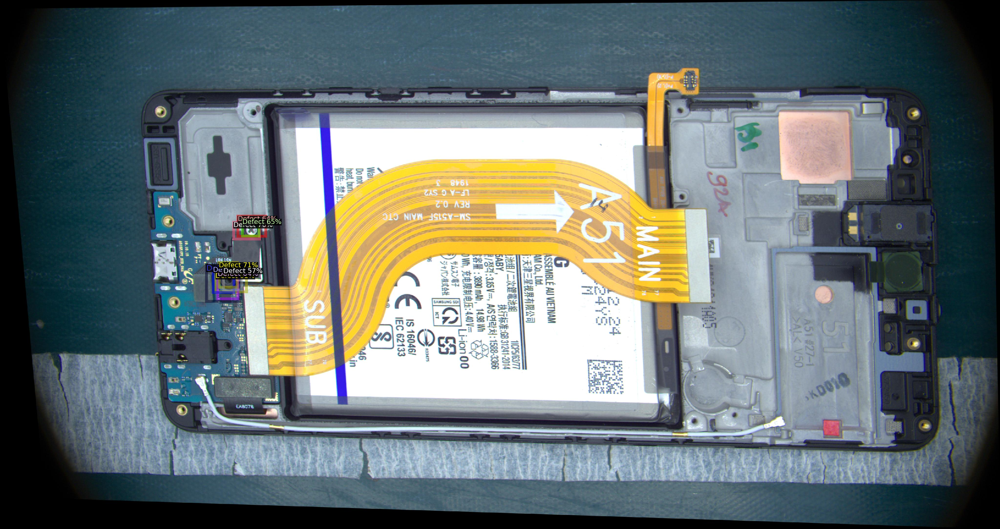

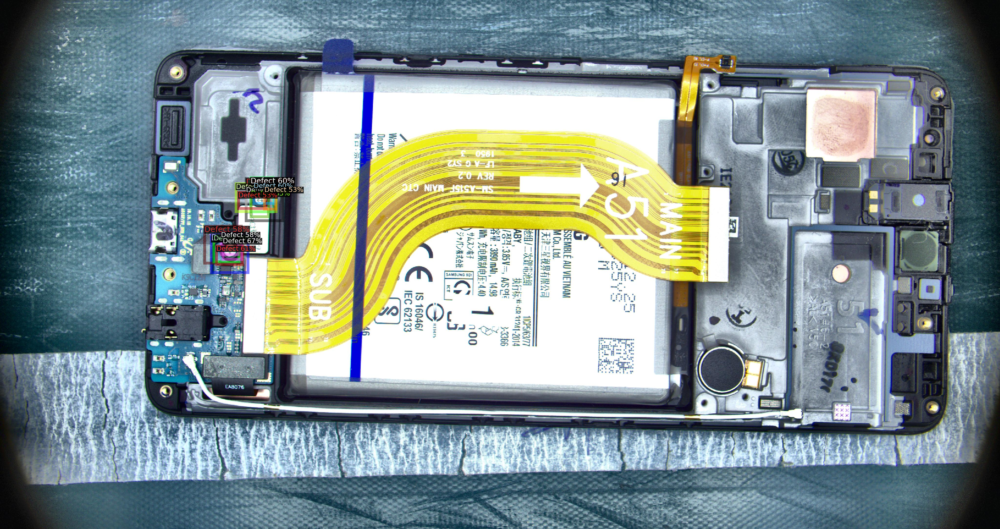

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
